In [1]:
import os
import shutil

def process_data_folder(data_path, folder_name):
    
    folder_path = os.path.join(data_path, folder_name)
    output_path = os.path.join("/kaggle/working", folder_name)
    images_output = os.path.join(output_path, 'images')
    labels_output = os.path.join(output_path, 'labels')
    os.makedirs(images_output, exist_ok=True)
    os.makedirs(labels_output, exist_ok=True)

    images_folder = os.path.join(folder_path, 'images')
    detections_folder = os.path.join(folder_path, 'detections')

    for subject in os.listdir(images_folder):
        subject_images_path = os.path.join(images_folder, subject)
        subject_detections_path = os.path.join(detections_folder, subject)

        if not os.path.isdir(subject_images_path):
            continue

        for image_name in os.listdir(subject_images_path):
            image_path = os.path.join(subject_images_path, image_name)
            image_id = os.path.splitext(image_name)[0]  

            new_image_name = f"{subject}_{image_id}.png"
            new_image_path = os.path.join(images_output, new_image_name)

            shutil.copy(image_path, new_image_path)

            label_file = os.path.join(subject_detections_path, f"{image_id}.txt")  
            new_label_name = f"{subject}_{image_id}.txt"  
            new_label_path = os.path.join(labels_output, new_label_name)

            if os.path.exists(label_file):
                with open(label_file, 'r') as f:
                    labels = f.readlines()

                if labels:
                    with open(new_label_path, 'w') as f:
                        f.writelines(labels)
                else:
                    print(f"Warning: The label file for {image_name} is empty. Creating empty label.")
                    open(new_label_path, 'w').close()
            else:
                open(new_label_path, 'w').close()
                print(f"Warning: No label file found for {image_name}. Creating empty label.")

    print(f"Processing of {folder_name} complete. Images saved in {images_output}, labels saved in {labels_output}.")

data_path = "/kaggle/input/computer-vision-project"
process_data_folder(data_path, 'train')
process_data_folder(data_path, 'val')

Processing of train complete. Images saved in /kaggle/working/train/images, labels saved in /kaggle/working/train/labels.
Processing of val complete. Images saved in /kaggle/working/val/images, labels saved in /kaggle/working/val/labels.


In [2]:
file_path = '/kaggle/working/train/labels/Subject_0_304.txt'

with open(file_path, 'r') as file:
    content = file.read()

print(content)

80,48,87,55



In [3]:
file_path = '/kaggle/working/train/labels/Subject_1_511.txt'

with open(file_path, 'r') as file:
    content = file.read()

print(content)

129,44,132,47
135,47,137,50



In [4]:
import os
from PIL import Image

def normalize_coordinates(image_width, image_height, xmin, ymin, xmax, ymax):
    
    x_center = (xmin + xmax) / 2 / image_width
    y_center = (ymin + ymax) / 2 / image_height
    width = (xmax - xmin) / image_width
    height = (ymax - ymin) / image_height
    return f"1 {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}"

def process_labels(labels_folder, images_folder):
   
    for label_file in os.listdir(labels_folder):
        
        label_path = os.path.join(labels_folder, label_file)
        image_name = os.path.splitext(label_file)[0] + ".png"  
        image_path = os.path.join(images_folder, image_name)
        
        if not os.path.exists(image_path):
            print(f"Image not found for {label_file}. Skipping.")
            continue
        
        with Image.open(image_path) as img:
            image_width, image_height = img.size
        
        with open(label_path, 'r') as file:
            content = file.read().strip()
        
        if content:  
            yolo_lines = []
            for line in content.splitlines():
                try:
                    xmin, ymin, xmax, ymax = map(int, line.split(','))
                    yolo_lines.append(normalize_coordinates(image_width, image_height, xmin, ymin, xmax, ymax))
                except ValueError:
                    print(f"Invalid content in {label_file}, skipping line: {line}")
            
            yolo_content = "\n".join(yolo_lines)
        else: 
            yolo_content = ""
        
        with open(label_path, 'w') as file:
            file.write(yolo_content)
        
        print(f"Processed and updated: {label_file}")

labels_folder = "/kaggle/working/train/labels"
images_folder = "/kaggle/working/train/images"

process_labels(labels_folder, images_folder)

labels_folder = "/kaggle/working/val/labels"
images_folder = "/kaggle/working/val/images"
process_labels(labels_folder, images_folder)

Processed and updated: Subject_37_197.txt
Processed and updated: Subject_45_116.txt
Processed and updated: Subject_40_114.txt
Processed and updated: Subject_54_129.txt
Processed and updated: Subject_35_52.txt
Processed and updated: Subject_46_115.txt
Processed and updated: Subject_14_0.txt
Processed and updated: Subject_30_101.txt
Processed and updated: Subject_43_128.txt
Processed and updated: Subject_34_66.txt
Processed and updated: Subject_6_109.txt
Processed and updated: Subject_38_195.txt
Processed and updated: Subject_45_121.txt
Processed and updated: Subject_38_233.txt
Processed and updated: Subject_30_151.txt
Processed and updated: Subject_38_190.txt
Processed and updated: Subject_14_188.txt
Processed and updated: Subject_5_128.txt
Processed and updated: Subject_2_101.txt
Processed and updated: Subject_51_187.txt
Processed and updated: Subject_4_11.txt
Processed and updated: Subject_29_72.txt
Processed and updated: Subject_52_126.txt
Processed and updated: Subject_51_197.txt
Pr

In [5]:
image_path = '/kaggle/working/val/images/Subject_58_301.png'
label_path = '/kaggle/working/val/labels/Subject_58_301.txt'

# show_bounding_boxes(image_path, label_path)

In [6]:
image_path = '/kaggle/working/val/images/Subject_60_50.png'
label_path = '/kaggle/working/val/labels/Subject_60_50.txt'

# show_bounding_boxes(image_path, label_path)

In [7]:
!pip install --upgrade pip

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 21.9 MB/s eta 0:00:0000:010:01
  Attempting uninstall: pip
    Found existing installation: pip 24.0
    Uninstalling pip-24.0:
      Successfully uninstalled pip-24.0


In [8]:
!pip install Ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 898.7/898.7 kB 20.2 MB/s eta 0:00:00


In [9]:
from ultralytics import YOLO
model= YOLO("yolo11l.pt")

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 49.0M/49.0M [00:00<00:00, 167MB/s]


In [10]:
yaml_content = """
path: /kaggle/working/
train: /kaggle/working/train/images
val: /kaggle/working/val/images
test: 

nc: 2
names:
  0: 'no_tumor'
  1: 'tumor'

"""

yaml_file_path = '/kaggle/working/data.yaml'

with open(yaml_file_path, 'w') as file:
    file.write(yaml_content)

print(f"YAML configuration file saved at: {yaml_file_path}")

YAML configuration file saved at: /kaggle/working/data.yaml


In [11]:
model.train(data='/kaggle/working/data.yaml',
            epochs=100,
            imgsz=640,
            batch=32,
            device="0,1",
            workers=8,
            augment=True,
            optimizer="adamW",
            lr0=0.0001,
           project="logs")

Ultralytics 8.3.49 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla T4, 15095MiB)
                                                 CUDA:1 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11l.pt, data=/kaggle/working/data.yaml, epochs=100, time=None, patience=100, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=0,1, workers=8, project=logs, name=train, exist_ok=False, pretrained=True, optimizer=adamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_con

100%|██████████| 755k/755k [00:00<00:00, 17.3MB/s]


Overriding model.yaml nc=80 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1      1856  ultralytics.nn.modules.conv.Conv             [3, 64, 3, 2]                 
  1                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  2                  -1  2    173824  ultralytics.nn.modules.block.C3k2            [128, 256, 2, True, 0.25]     
  3                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
  4                  -1  2    691712  ultralytics.nn.modules.block.C3k2            [256, 512, 2, True, 0.25]     
  5                  -1  1   2360320  ultralytics.nn.modules.conv.Conv             [512, 512, 3, 2]              
  6                  -1  2   2234368  ultralytics.nn.modules.block.C3k2            [512, 512, 2, True]           
  7                  -1  1   2360320  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 75.3MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/working/train/labels... 1832 images, 285 backgrounds, 0 corrupt: 100%|██████████| 1832/1832 [00:01<00:00, 1068.50it/s]


train: New cache created: /kaggle/working/train/labels.cache


/opt/conda/lib/python3.10/site-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.22 (you have 1.4.21). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /kaggle/working/val/labels... 98 images, 20 backgrounds, 0 corrupt: 100%|██████████| 98/98 [00:00<00:00, 1298.72it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: New cache created: /kaggle/working/val/labels.cache


/opt/conda/lib/python3.10/site-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.22 (you have 1.4.21). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


Plotting labels to logs/train/labels.jpg... 
optimizer: AdamW(lr=0.0001, momentum=0.937) with parameter groups 167 weight(decay=0.0), 174 weight(decay=0.0005), 173 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to logs/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      11.2G      1.908      3.414      1.631          4        640: 100%|██████████| 58/58 [00:45<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.54it/s]


                   all         98         86       0.75     0.0698      0.408      0.217

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      11.1G      1.633      1.268      1.402          8        640: 100%|██████████| 58/58 [00:45<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]


                   all         98         86      0.681      0.546      0.572      0.288

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      11.1G      1.517      1.123       1.36          8        640: 100%|██████████| 58/58 [00:47<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.08it/s]


                   all         98         86      0.785        0.5      0.578      0.289

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      11.1G      1.462      1.003      1.294          4        640: 100%|██████████| 58/58 [00:46<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86      0.792      0.547      0.564      0.288

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      11.1G      1.499     0.9181        1.3          5        640: 100%|██████████| 58/58 [00:47<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86      0.754      0.558       0.61      0.344

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      11.1G      1.359     0.8759      1.239          5        640: 100%|██████████| 58/58 [00:47<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.06it/s]


                   all         98         86      0.752      0.672      0.703       0.39

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      11.1G      1.389     0.8655      1.234          4        640: 100%|██████████| 58/58 [00:47<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86      0.832      0.593      0.651      0.305

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      11.1G      1.339     0.7998      1.227          5        640: 100%|██████████| 58/58 [00:47<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]


                   all         98         86       0.81      0.643      0.656       0.28

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      11.1G      1.326     0.8196      1.174          5        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.05it/s]


                   all         98         86      0.718       0.65      0.658      0.368

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      11.1G      1.276      0.756      1.187          5        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.05it/s]


                   all         98         86      0.762      0.593      0.629      0.321

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      11.1G      1.229     0.7359      1.154          4        640: 100%|██████████| 58/58 [00:47<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.06it/s]


                   all         98         86      0.845      0.535      0.626      0.314

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      11.1G      1.258     0.7019       1.18          7        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.06it/s]


                   all         98         86      0.758      0.593      0.619      0.315

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      11.1G      1.262     0.7103      1.188          5        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86      0.888      0.605      0.674      0.372

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      11.1G      1.232     0.7077      1.131          6        640: 100%|██████████| 58/58 [00:47<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.02it/s]


                   all         98         86      0.906      0.558      0.647      0.334

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      11.2G      1.192     0.6806      1.135          6        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.05it/s]


                   all         98         86      0.821      0.651      0.663      0.353

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      11.2G      1.192     0.6565      1.139          6        640: 100%|██████████| 58/58 [00:47<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.06it/s]


                   all         98         86      0.802       0.66      0.677      0.363

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      11.2G      1.158     0.6513      1.116          5        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.05it/s]


                   all         98         86      0.835      0.646      0.689      0.363

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      11.1G      1.147     0.6244      1.123          6        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.05it/s]


                   all         98         86      0.888       0.57      0.622      0.307

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      11.1G      1.215     0.6669      1.138          4        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.06it/s]


                   all         98         86      0.766      0.663      0.665      0.358

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      11.1G      1.151     0.6387      1.131          5        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.08it/s]


                   all         98         86      0.919      0.605      0.679      0.362

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      11.1G       1.13     0.6128      1.094          5        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.04it/s]


                   all         98         86      0.802      0.605      0.594      0.329

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      11.2G      1.097     0.6059      1.059          5        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.06it/s]


                   all         98         86       0.79      0.568      0.601      0.319

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      11.1G      1.086     0.5946      1.065          8        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.06it/s]


                   all         98         86      0.887      0.581      0.671      0.369

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      11.2G      1.051     0.5625      1.063          3        640: 100%|██████████| 58/58 [00:47<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.06it/s]


                   all         98         86      0.925      0.575      0.677      0.377

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      11.1G      1.089     0.5928      1.071          2        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]


                   all         98         86      0.806       0.57      0.618      0.332

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      11.1G       1.08     0.5693      1.056          8        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.06it/s]


                   all         98         86      0.761      0.631      0.648      0.341

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      11.1G      1.062     0.5663      1.042         11        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.05it/s]


                   all         98         86      0.845      0.632      0.671      0.381

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      11.1G      1.078     0.5593      1.068          7        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.06it/s]


                   all         98         86      0.845      0.605      0.659      0.362

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      11.1G      1.078     0.5497      1.035          5        640: 100%|██████████| 58/58 [00:47<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.08it/s]


                   all         98         86      0.803      0.615      0.643      0.357

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      11.1G      1.025     0.5251      1.036          3        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]


                   all         98         86      0.805       0.64      0.685      0.355

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      11.1G      1.054      0.531      1.036          6        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]


                   all         98         86      0.854      0.615      0.644      0.333

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      11.1G      1.025      0.533      1.031          5        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.04it/s]


                   all         98         86      0.852       0.67      0.664      0.353

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      11.1G      1.026     0.5179      1.052          3        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.05it/s]


                   all         98         86      0.873      0.637      0.653      0.327

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      11.1G      1.009     0.5163      1.029          3        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]


                   all         98         86      0.885      0.625       0.68      0.371

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      11.1G      1.008     0.5213      1.032          4        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.06it/s]


                   all         98         86      0.838      0.581       0.61      0.333

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      11.1G     0.9916     0.5209      1.024          6        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]


                   all         98         86      0.802      0.593      0.608      0.323

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      11.1G     0.9683     0.4929      1.028          6        640: 100%|██████████| 58/58 [00:47<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.06it/s]


                   all         98         86      0.822      0.593      0.637      0.332

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      11.1G     0.9853     0.4913      1.008          5        640: 100%|██████████| 58/58 [00:47<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]


                   all         98         86      0.857      0.581      0.618      0.343

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      11.1G     0.9358     0.4769      1.011          4        640: 100%|██████████| 58/58 [00:47<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]


                   all         98         86      0.841      0.581      0.635      0.351

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      11.1G     0.9734     0.5196      1.007          2        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]


                   all         98         86      0.737      0.652      0.658      0.332

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      11.1G     0.9257     0.4882      1.002          6        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]


                   all         98         86      0.829      0.605      0.658      0.378

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      11.1G     0.9343     0.4729     0.9968         13        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.05it/s]


                   all         98         86      0.879      0.651      0.683      0.347

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      11.1G      0.958     0.4719      1.001          6        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]


                   all         98         86      0.833      0.636      0.637      0.328

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      11.1G     0.9418     0.4859     0.9959          4        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.05it/s]


                   all         98         86      0.855      0.615      0.646      0.344

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      11.1G     0.8911      0.462       0.98          3        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86      0.754      0.593      0.649      0.346

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      11.1G     0.8912     0.4472     0.9847          5        640: 100%|██████████| 58/58 [00:47<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]


                   all         98         86      0.867      0.558      0.656      0.362

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      11.1G      0.903     0.4435     0.9807          6        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.06it/s]


                   all         98         86      0.804      0.622      0.662       0.37

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      11.1G     0.9025     0.4501     0.9882          3        640: 100%|██████████| 58/58 [00:47<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.06it/s]


                   all         98         86      0.793      0.616      0.664      0.372

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      11.1G      0.904     0.4551      0.976          2        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]


                   all         98         86      0.887      0.636      0.695      0.385

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      11.1G     0.8676     0.4459     0.9841          6        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]


                   all         98         86      0.795      0.581      0.639      0.355

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      11.1G     0.9027     0.4507     0.9743          4        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.06it/s]


                   all         98         86      0.825      0.659      0.685       0.37

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      11.1G     0.8298     0.4259     0.9618          1        640: 100%|██████████| 58/58 [00:47<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86      0.873      0.593        0.7      0.375

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      11.1G     0.8406      0.425     0.9541          3        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.08it/s]


                   all         98         86      0.786      0.605      0.643      0.347

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      11.1G     0.8891     0.4332     0.9729          7        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.08it/s]


                   all         98         86      0.859      0.581      0.649      0.357

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      11.1G     0.8708     0.4255     0.9661         14        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.06it/s]


                   all         98         86      0.796      0.591      0.635      0.345

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      11.1G     0.8392     0.4118     0.9657          3        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86      0.856      0.605      0.638      0.365

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      11.1G     0.8297     0.4118     0.9437          2        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]


                   all         98         86      0.854       0.61      0.695      0.393

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      11.1G     0.8569     0.4229     0.9522          1        640: 100%|██████████| 58/58 [00:47<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86      0.865      0.616      0.675      0.356

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      11.2G     0.8456     0.4105     0.9501          6        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.10it/s]


                   all         98         86      0.864      0.616      0.651      0.343

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      11.1G     0.8632     0.4317      0.968          5        640: 100%|██████████| 58/58 [00:47<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86      0.852      0.604       0.66       0.36

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      11.1G     0.8186     0.4056      0.945          6        640: 100%|██████████| 58/58 [00:47<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86      0.825      0.601      0.619      0.341

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      11.1G     0.8024     0.3946     0.9346          7        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.05it/s]


                   all         98         86      0.804      0.628      0.659      0.362

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      11.1G     0.7572     0.3828     0.9394          6        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]


                   all         98         86      0.771      0.581      0.641      0.348

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      11.1G     0.7934     0.3929      0.932          7        640: 100%|██████████| 58/58 [00:47<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.10it/s]


                   all         98         86      0.838      0.616      0.669      0.377

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      11.1G     0.8141     0.4083     0.9513          3        640: 100%|██████████| 58/58 [00:47<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.08it/s]


                   all         98         86       0.87      0.593       0.65      0.382

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      11.1G     0.7662     0.3908     0.9235          6        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]


                   all         98         86      0.873      0.581      0.649      0.348

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      11.1G     0.7751     0.3856      0.921          4        640: 100%|██████████| 58/58 [00:47<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.10it/s]


                   all         98         86      0.785      0.637       0.66      0.356

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      11.1G     0.7636     0.3743     0.9254          5        640: 100%|██████████| 58/58 [00:47<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]


                   all         98         86      0.758      0.583      0.639      0.351

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      11.1G     0.7687     0.3815     0.9287          7        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.08it/s]


                   all         98         86      0.807      0.585      0.652      0.362

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      11.1G     0.7475     0.3769     0.9186          2        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]


                   all         98         86      0.812      0.651      0.673      0.372

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      11.1G     0.7555     0.3732     0.9266          6        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86      0.849      0.651      0.683      0.372

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      11.1G     0.7885      0.393     0.9196          2        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86      0.773      0.634      0.675      0.373

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      11.1G     0.7503     0.3661     0.9122          4        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86      0.809      0.628      0.663      0.359

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      11.1G     0.7423     0.3742     0.9091          7        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86      0.803      0.628      0.671      0.379

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      11.1G     0.7258     0.3592     0.9017          3        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.10it/s]


                   all         98         86      0.817      0.605      0.679      0.381

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      11.1G     0.7342     0.3742     0.9042          4        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.08it/s]


                   all         98         86      0.835      0.605      0.673      0.389

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      11.1G     0.7473     0.3716     0.9101          3        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86      0.847      0.616      0.677      0.365

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      11.2G     0.6976     0.3528     0.8987          2        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86      0.818       0.64       0.66      0.358

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      11.1G     0.7223     0.3487      0.894          6        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.08it/s]


                   all         98         86       0.85      0.628      0.665      0.354

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      11.1G     0.6897     0.3469     0.8903          4        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.08it/s]


                   all         98         86      0.842      0.628      0.678      0.377

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      11.1G     0.7193     0.3512      0.902          3        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86      0.843      0.626      0.688       0.39

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      11.1G     0.6929     0.3499     0.8927          6        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86       0.84      0.581      0.673      0.372

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      11.1G      0.684     0.3429       0.89          4        640: 100%|██████████| 58/58 [00:47<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86       0.79      0.593      0.687       0.38

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      11.2G     0.6941     0.3511     0.8932          6        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86       0.81      0.595      0.662      0.364

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      11.1G     0.6869     0.3581     0.9099          4        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86      0.765      0.593      0.673      0.373

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      11.1G      0.685      0.333     0.8941          5        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.08it/s]


                   all         98         86      0.819      0.628       0.68      0.372

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      11.1G     0.7026     0.3417      0.895          2        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86      0.808      0.616      0.663      0.361

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      11.1G     0.6736     0.3299     0.8911          4        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.08it/s]


                   all         98         86      0.838      0.616      0.671      0.376

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      11.1G     0.6378     0.3219     0.8854          5        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86       0.81      0.616      0.671      0.369

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      11.1G     0.6533     0.3232     0.8799          2        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86      0.791      0.616      0.684      0.385
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      11.1G      0.622     0.2935     0.8654          4        640: 100%|██████████| 58/58 [00:48<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]


                   all         98         86      0.813      0.616      0.696      0.385

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      11.1G     0.6092     0.2878      0.866          4        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86      0.823      0.648      0.703      0.394

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      11.1G     0.5972     0.2805     0.8496          5        640: 100%|██████████| 58/58 [00:47<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.10it/s]


                   all         98         86      0.807      0.632      0.692      0.391

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      11.1G     0.5644      0.276     0.8388          1        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.08it/s]


                   all         98         86      0.787      0.628       0.68      0.384

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      11.1G     0.5992     0.2885     0.8469          4        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.10it/s]


                   all         98         86      0.784      0.632      0.693      0.387

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      11.1G     0.5746     0.2811     0.8581          4        640: 100%|██████████| 58/58 [00:47<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86      0.824      0.605      0.686       0.38

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      11.1G     0.5705     0.2698      0.841          4        640: 100%|██████████| 58/58 [00:48<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86       0.82      0.605      0.672      0.373

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      11.1G     0.5723     0.2742     0.8456          4        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86      0.808      0.605      0.665      0.371

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      11.1G     0.5851     0.2722     0.8494          4        640: 100%|██████████| 58/58 [00:47<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]


                   all         98         86      0.809      0.605      0.673      0.372

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      11.1G     0.5599      0.272       0.83          4        640: 100%|██████████| 58/58 [00:48<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.08it/s]


                   all         98         86      0.809      0.605      0.666      0.372

100 epochs completed in 1.431 hours.
Optimizer stripped from logs/train/weights/last.pt, 51.2MB
Optimizer stripped from logs/train/weights/best.pt, 51.2MB

Validating logs/train/weights/best.pt...
Ultralytics 8.3.49 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla T4, 15095MiB)
                                                 CUDA:1 (Tesla T4, 15095MiB)
YOLO11l summary (fused): 464 layers, 25,280,854 parameters, 0 gradients, 86.6 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.14s/it]


                   all         98         86      0.828      0.674      0.687      0.368
                 tumor         78         86      0.828      0.674      0.687      0.368
Speed: 0.2ms preprocess, 43.4ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to logs/train



image 1/98 /kaggle/working/val/images/Subject_57_0.png: 640x640 (no detections), 47.5ms
image 2/98 /kaggle/working/val/images/Subject_57_1.png: 640x640 (no detections), 40.6ms
image 3/98 /kaggle/working/val/images/Subject_57_10.png: 640x640 (no detections), 40.6ms
image 4/98 /kaggle/working/val/images/Subject_57_100.png: 640x640 (no detections), 40.6ms
image 5/98 /kaggle/working/val/images/Subject_57_101.png: 640x640 (no detections), 40.6ms
image 6/98 /kaggle/working/val/images/Subject_57_201.png: 640x640 1 tumor, 26.4ms
image 7/98 /kaggle/working/val/images/Subject_57_202.png: 640x640 1 tumor, 23.8ms
image 8/98 /kaggle/working/val/images/Subject_57_203.png: 640x640 1 tumor, 24.4ms
image 9/98 /kaggle/working/val/images/Subject_57_204.png: 640x640 1 tumor, 27.1ms
image 10/98 /kaggle/working/val/images/Subject_57_205.png: 640x640 1 tumor, 25.4ms
image 11/98 /kaggle/working/val/images/Subject_57_206.png: 640x640 1 tumor, 26.7ms
image 12/98 /kaggle/working/val/images/Subject_57_207.png: 6

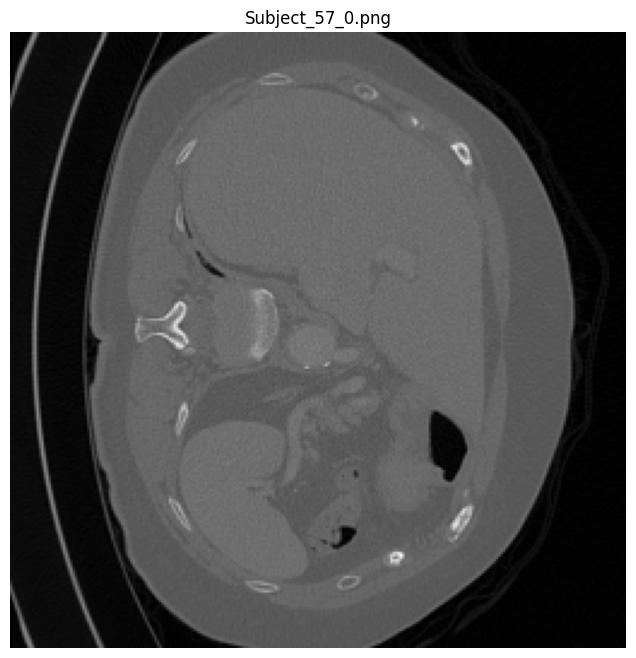

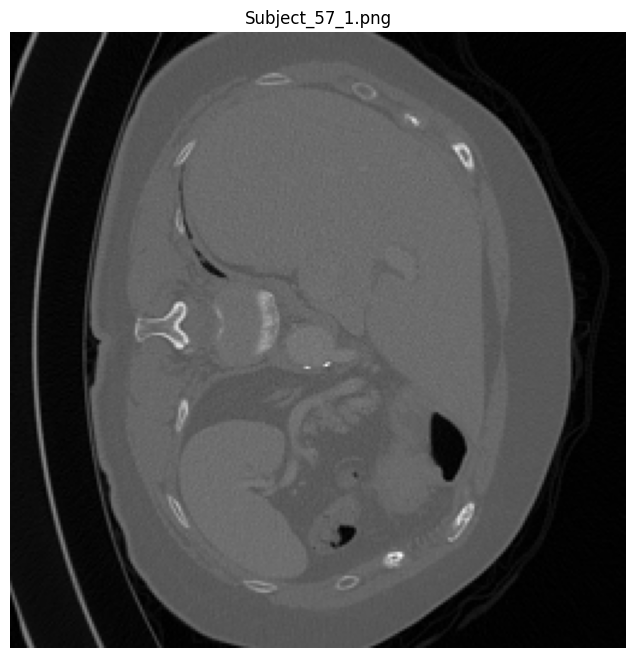

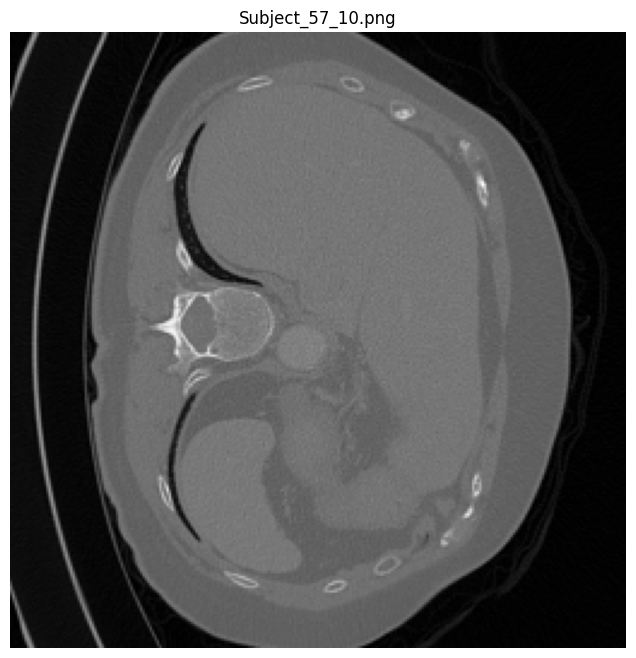

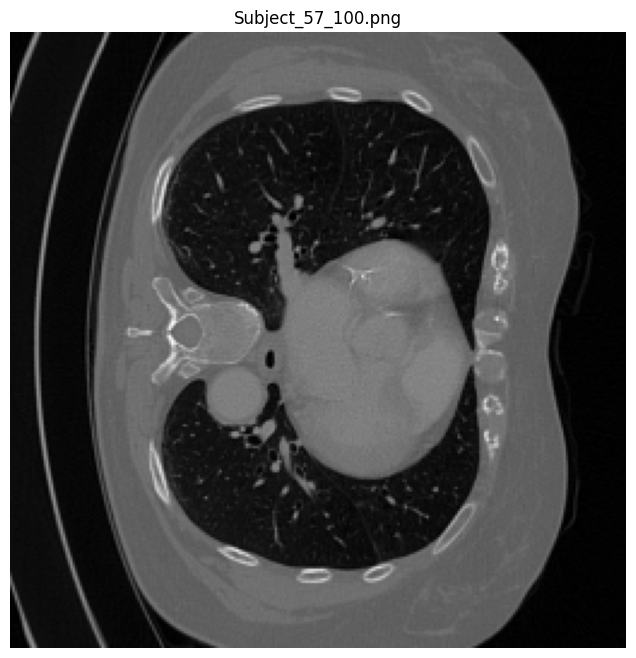

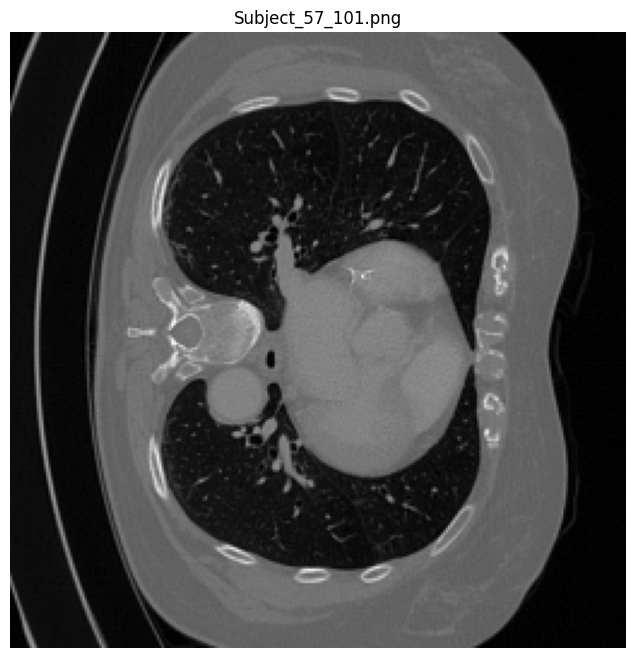

...

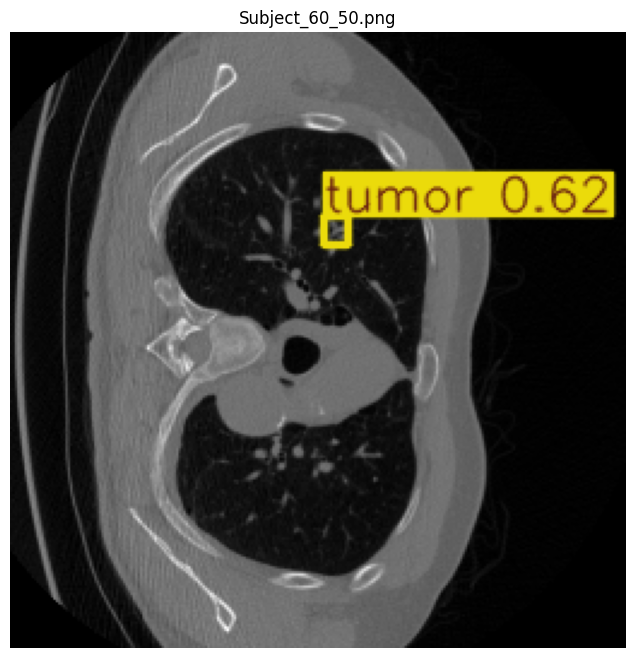

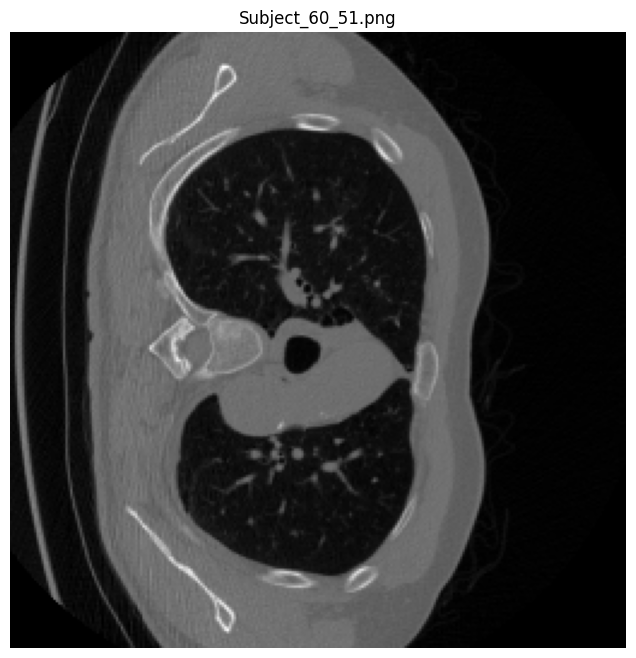

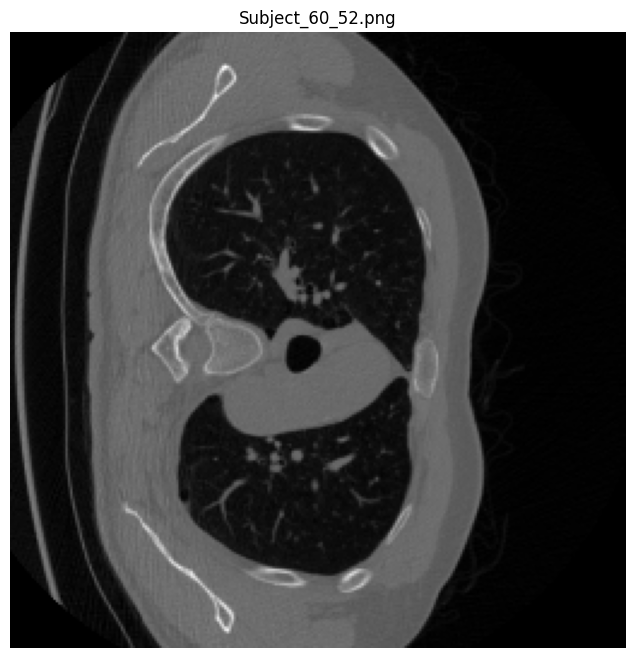

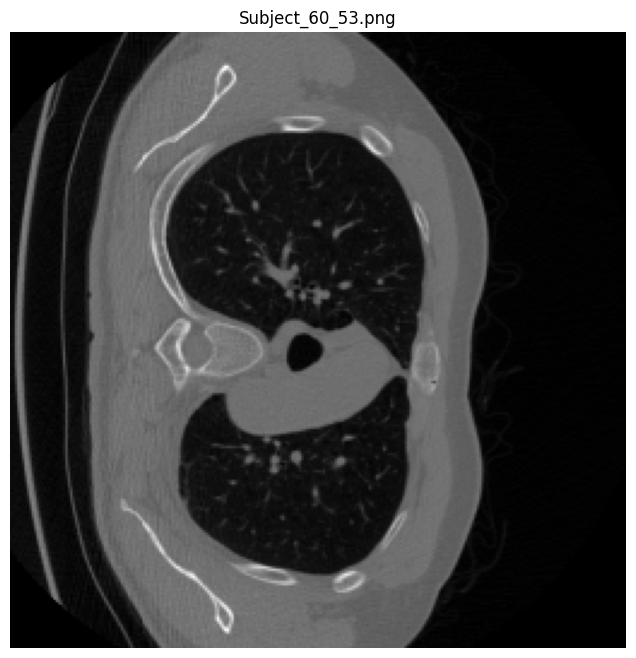

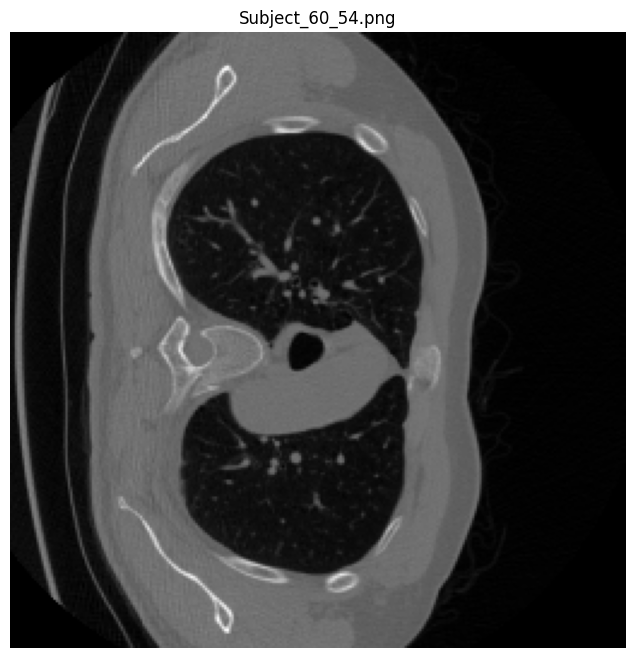

In [14]:
from ultralytics import YOLO
import cv2
import matplotlib.pyplot as plt
import os

trained_model = YOLO("/kaggle/working/logs/train/weights/best.pt")

all_results = trained_model(source="/kaggle/working/val/images" ,conf=0.2 ,save=False)

image_dir = "/kaggle/working/val/images"
image_files = sorted(os.listdir(image_dir))  

for i, result in enumerate(all_results[:]):  
    image_path = os.path.join(image_dir, image_files[i])
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  

    annotated_image = result.plot()
    
    plt.figure(figsize=(8, 8))
    plt.imshow(annotated_image)
    plt.axis("off")
    plt.title(image_files[i])  
    plt.show()

In [15]:
results = model.val()
print(results)

Ultralytics 8.3.49 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla T4, 15095MiB)
                                                 CUDA:1 (Tesla T4, 15095MiB)
YOLO11l summary (fused): 464 layers, 25,280,854 parameters, 0 gradients, 86.6 GFLOPs


val: Scanning /kaggle/working/val/labels.cache... 98 images, 20 backgrounds, 0 corrupt: 100%|██████████| 98/98 [00:00<?, ?it/s]
/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.26s/it]


                   all         98         86      0.828      0.674      0.686      0.369
                 tumor         78         86      0.828      0.674      0.686      0.369
Speed: 0.2ms preprocess, 84.6ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to logs/train2
ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7a29fc19d720>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    